### Symulacja wahadła podwójnego

In [2]:
# Generowanie wielu trajektorii wahadła podwójnego

import numpy as np
from scipy.integrate import solve_ivp
from sklearn.model_selection import train_test_split

# Definicja równań ruchu wahadła podwójnego
def equations(t, y):
    theta1, z1, theta2, z2 = y
    c, s = np.cos(theta1 - theta2), np.sin(theta1 - theta2)

    theta1_dot = z1
    z1_dot = (m2 * g * np.sin(theta2) * c - m2 * s * (L1 * z1**2 * c + L2 * z2**2) -
              (m1 + m2) * g * np.sin(theta1)) / L1 / (m1 + m2 * s**2)
    theta2_dot = z2
    z2_dot = ((m1 + m2) * (L1 * z1**2 * s - g * np.sin(theta2) + g * np.sin(theta1) * c) +
              m2 * L2 * z2**2 * s * c) / L2 / (m1 + m2 * s**2)
    return [theta1_dot, z1_dot, theta2_dot, z2_dot]

# Parametry wahadła
m1, m2 = 1.0, 1.0  # masy wahadeł
L1, L2 = 1.0, 1.0  # długości prętów
g = 9.81  # przyspieszenie ziemskie

# Zakres czasu symulacji
t_span = (0, 10)
t_eval = np.linspace(0, 10, 1000)

num_trajectories = 100  # liczba trajektorii do wygenerowania
trajectories = []

for i in range(num_trajectories):
    # Losowe warunki początkowe
    y0 = [np.pi + np.random.uniform(-1.0, 1.0), 0, np.pi + np.random.uniform(-1.0, 1.0), 0]
    sol = solve_ivp(equations, t_span, y0, t_eval=t_eval)
    trajectories.append(np.column_stack((sol.y[0], sol.y[1], sol.y[2], sol.y[3])))

# Konwersja listy trajektorii do tablicy numpy
trajectories = np.array(trajectories)

# Przygotowanie danych do modelu RNN
sequence_length = 10  # liczba kroków czasowych w sekwencji
X, y = [], []
for traj in trajectories:
    for i in range(len(traj) - sequence_length):
        X.append(traj[i:i + sequence_length])
        y.append(traj[i + sequence_length])

X = np.array(X)
y = np.array(y)

# Podział na zbiór treningowy i testowy
split_index = int(len(X) * 0.2)
# Podział na zbiór treningowy i testowy
X_test, y_test = X[:split_index], y[:split_index]
X_train, y_train = X[split_index:], y[split_index:]

print(f"Shape of X_train: {X_train.shape}")
print(f"Shape of y_train: {y_train.shape}")
print(f"Shape of X_test: {X_test.shape}")
print(f"Shape of y_test: {y_test.shape}")


Shape of X_train: (79200, 10, 4)
Shape of y_train: (79200, 4)
Shape of X_test: (19800, 10, 4)
Shape of y_test: (19800, 4)


### Modelowanie RNN dla wahadła podwójnego

In [3]:
import os
import tensorflow as tf

# Define the model save path
model_save_path = "rnn_model.h5"

# Check if the model is already saved
if os.path.exists(model_save_path):
    # Load the model if it exists
    model = tf.keras.models.load_model(model_save_path)
    print("Model loaded from disk.")
else:
    # Build and train the model if it doesn't exist
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(sequence_length, X_train.shape[2])),
        tf.keras.layers.SimpleRNN(64, activation='tanh', return_sequences=True),
        tf.keras.layers.SimpleRNN(64, activation='tanh'),
        tf.keras.layers.Dense(y_train.shape[1])
    ])

    model.compile(optimizer='adam', loss='mse', metrics=['mae'])

    # Train the model
    history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2)

    # Save the model to disk
    model.save(model_save_path)
    print("Model trained and saved to disk.")


2025-01-29 15:23:52.822617: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-01-29 15:23:53.277680: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-01-29 15:23:53.280659: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-01-29 15:23:55.284386: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2025-01-29 15:23:57.994959: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-01-29 15:23:57.995996: W tensorflow/core/common_r

Epoch 1/50
1980/1980 [==============================] - 17s 7ms/step - loss: 7.8751 - mae: 1.1383 - val_loss: 1.7182 - val_mae: 0.4338
Epoch 2/50
1980/1980 [==============================] - 14s 7ms/step - loss: 0.2733 - mae: 0.2405 - val_loss: 0.4016 - val_mae: 0.2398
Epoch 3/50
1980/1980 [==============================] - 13s 7ms/step - loss: 0.0709 - mae: 0.1511 - val_loss: 0.1355 - val_mae: 0.1669
Epoch 4/50
1980/1980 [==============================] - 13s 6ms/step - loss: 0.0316 - mae: 0.1159 - val_loss: 0.0655 - val_mae: 0.1196
Epoch 5/50
1980/1980 [==============================] - 13s 7ms/step - loss: 0.0220 - mae: 0.1002 - val_loss: 0.0528 - val_mae: 0.1167
Epoch 6/50
1980/1980 [==============================] - 19s 9ms/step - loss: 0.0190 - mae: 0.0944 - val_loss: 0.0381 - val_mae: 0.1062
Epoch 7/50
1980/1980 [==============================] - 15s 8ms/step - loss: 0.0182 - mae: 0.0936 - val_loss: 0.0417 - val_mae: 0.1305
Epoch 8/50
1980/1980 [==============================] -

/home/kieru/.local/lib/python3.8/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Model trained and saved to disk.


619/619 [==============================] - 3s 4ms/step


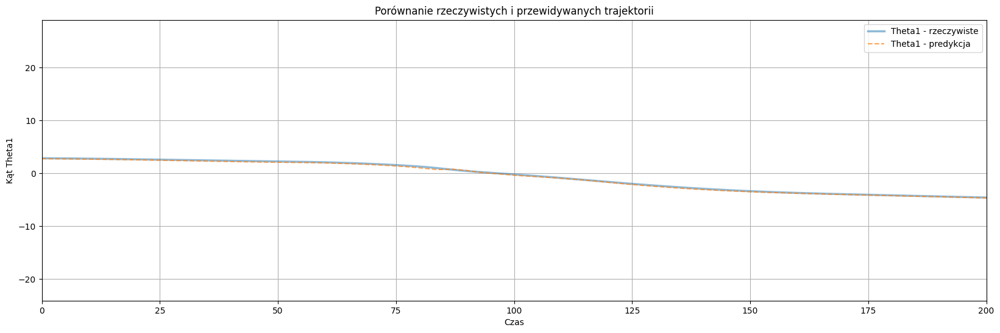

In [4]:
# Przewidywanie trajektorii
y_pred = model.predict(X_test)

# Porównanie trajektorii
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 6))
plt.plot(y_test[:, 0], label='Theta1 - rzeczywiste', alpha=0.5, linewidth=2.5)
plt.plot(y_pred[:, 0], label='Theta1 - predykcja', linestyle='dashed', alpha=0.7) 
plt.title('Porównanie rzeczywistych i przewidywanych trajektorii')
plt.xlabel('Czas')
plt.ylabel('Kąt Theta1')
plt.xlim(0, 200)
plt.legend()
plt.grid()
plt.show()


619/619 [==============================] - 4s 6ms/step


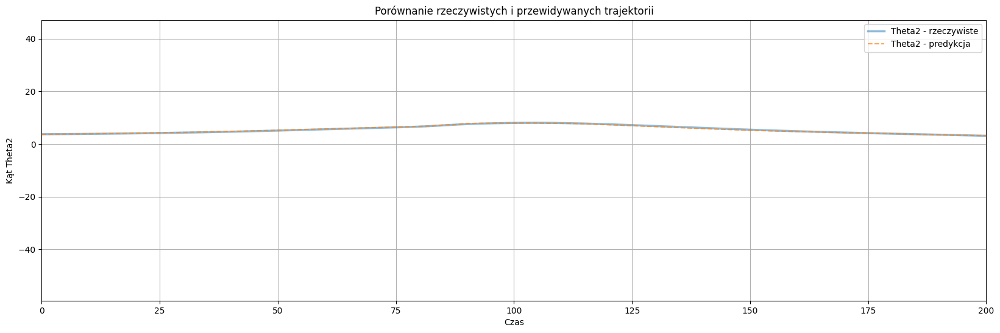

In [5]:
# Przewidywanie trajektorii
y_pred = model.predict(X_test)

# Porównanie trajektorii
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 6))
plt.plot(y_test[:, 2], label='Theta2 - rzeczywiste', alpha=0.5, linewidth=2.5)
plt.plot(y_pred[:, 2], label='Theta2 - predykcja', linestyle='dashed', alpha=0.7) 
plt.title('Porównanie rzeczywistych i przewidywanych trajektorii')
plt.xlabel('Czas')
plt.ylabel('Kąt Theta2')
plt.xlim(0, 200)
plt.legend()
plt.grid()
plt.show()

Animation size has reached 20971606 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


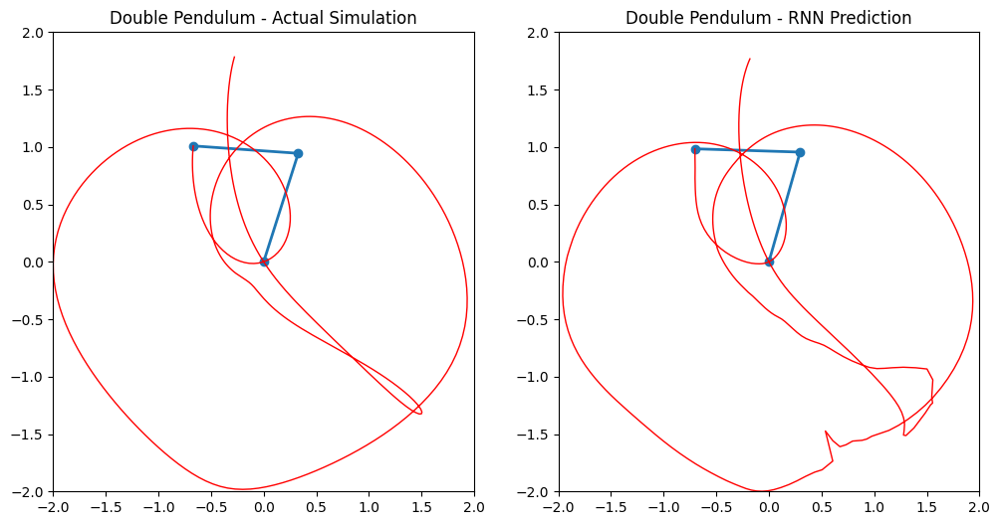

In [6]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np
import matplotlib.pyplot as plt

# Function to convert angles to x, y coordinates
def angles_to_coordinates(theta1, theta2, l1, l2):
    x1 = l1 * np.sin(theta1)
    y1 = -l1 * np.cos(theta1)
    x2 = x1 + l2 * np.sin(theta2)
    y2 = y1 - l2 * np.cos(theta2)
    return x1, y1, x2, y2

# Actual pendulum coordinates
real_x1, real_y1, real_x2, real_y2 = angles_to_coordinates(y_test[:, 0], y_test[:, 2], L1, L2)

# Predicted pendulum coordinates from RNN
pred_theta1 = y_pred[:, 0]
pred_theta2 = y_pred[:, 2]

pred_x1, pred_y1, pred_x2, pred_y2 = angles_to_coordinates(pred_theta1[:len(real_x1)], pred_theta2[:len(real_x1)], L1, L2)

# Ensure frames match the shortest dataset
num_frames = min(len(real_x1), len(pred_x1))
num_frames = 400

# Set up the figure and axes
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
ax[0].set_xlim(-2, 2)
ax[0].set_ylim(-2, 2)
ax[0].set_title("Double Pendulum - Actual Simulation")
ax[1].set_xlim(-2, 2)
ax[1].set_ylim(-2, 2)
ax[1].set_title("Double Pendulum - RNN Prediction")

# Lines for both pendulums
real_line, = ax[0].plot([], [], 'o-', lw=2)
pred_line, = ax[1].plot([], [], 'o-', lw=2)

# Permanent lines for the tips of the pendulums
real_tip_line, = ax[0].plot([], [], 'r-', lw=1)
pred_tip_line, = ax[1].plot([], [], 'r-', lw=1)

# Lists to store the tip coordinates
real_tip_x, real_tip_y = [], []
pred_tip_x, pred_tip_y = [], []

# Update function for the animation
def update(frame):
    # Update real pendulum
    real_line.set_data(
        [0, real_x1[frame], real_x2[frame]],
        [0, real_y1[frame], real_y2[frame]],
    )
    real_tip_x.append(real_x2[frame])
    real_tip_y.append(real_y2[frame])
    real_tip_line.set_data(real_tip_x, real_tip_y)
    
    # Update predicted pendulum
    pred_line.set_data(
        [0, pred_x1[frame], pred_x2[frame]],
        [0, pred_y1[frame], pred_y2[frame]],
    )
    pred_tip_x.append(pred_x2[frame])
    pred_tip_y.append(pred_y2[frame])
    pred_tip_line.set_data(pred_tip_x, pred_tip_y)
    
    return real_line, pred_line, real_tip_line, pred_tip_line

# Create the animation
anim = FuncAnimation(fig, update, frames=num_frames, interval=20, blit=True)

# Display the animation
HTML(anim.to_jshtml())
